# Exploratory data analysis 

In [4]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

## Genearal information

In [5]:
import os

# Define the folder paths
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"
classes = ["Normal", "Osteopenia", "Osteoporosis"]

# Initialize total count
total_images = 0

# Count images in each class
for cls in classes:
    folder_path = os.path.join(base_path, cls)
    num_images = len(os.listdir(folder_path))
    total_images += num_images
    print(f"{cls}: {num_images} images")

# Print total count
print(f"Total images in the dataset: {total_images}")

Normal: 297 images
Osteopenia: 370 images
Osteoporosis: 276 images
Total images in the dataset: 943


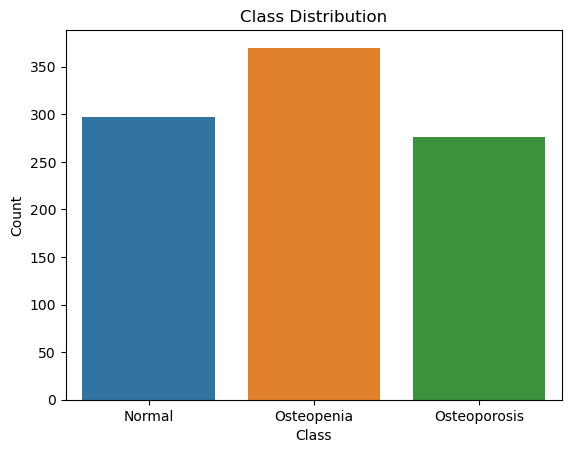

In [6]:
import seaborn as sns
import pandas as pd

# Create a DataFrame for visualization
data = {"Class": [], "Count": []}
for cls in classes:
    folder_path = os.path.join(base_path, cls)
    num_images = len(os.listdir(folder_path))
    data["Class"].append(cls)
    data["Count"].append(num_images)

df = pd.DataFrame(data)

# Plot
sns.barplot(data=df, x="Class", y="Count")
plt.title("Class Distribution")
plt.show()

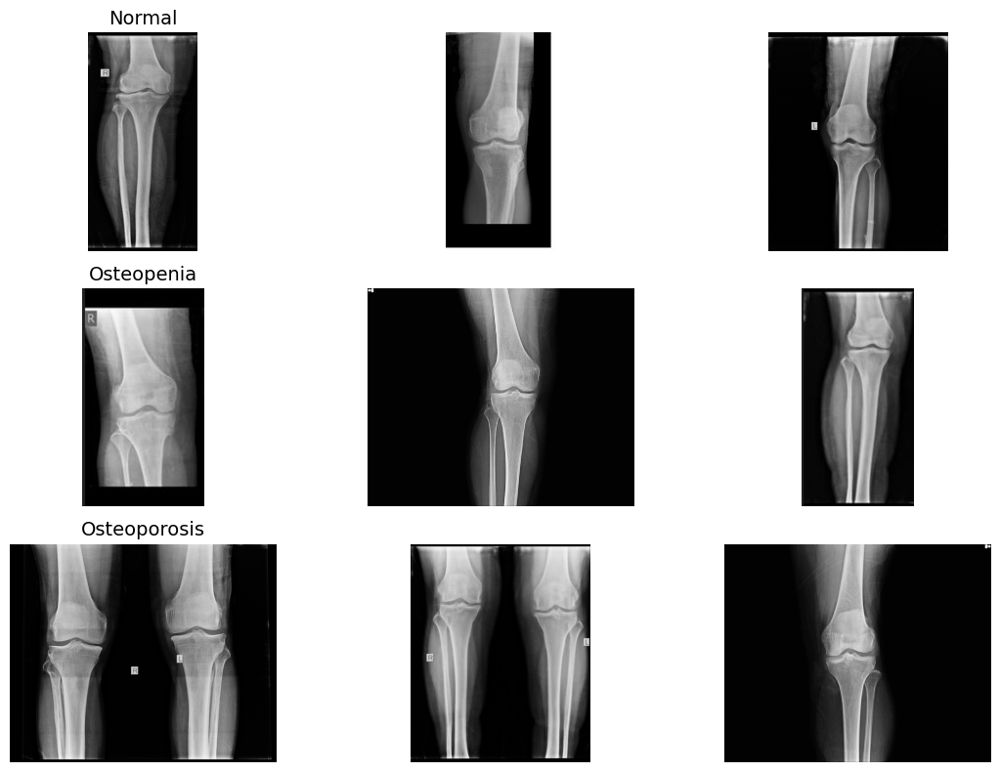

In [7]:
import random
# Display random sample images
fig, axes = plt.subplots(len(classes), 3, figsize=(12, 8))
for i, cls in enumerate(classes):
    folder_path = os.path.join(base_path, cls)
    sample_imgs = random.sample(os.listdir(folder_path), 3)
    for j, img_name in enumerate(sample_imgs):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path)
        axes[i, j].imshow(img, cmap="gray")
        axes[i, j].axis("off")
        if j == 0:
            axes[i, j].set_title(cls, fontsize=14)
plt.tight_layout()
plt.show()

## Image information

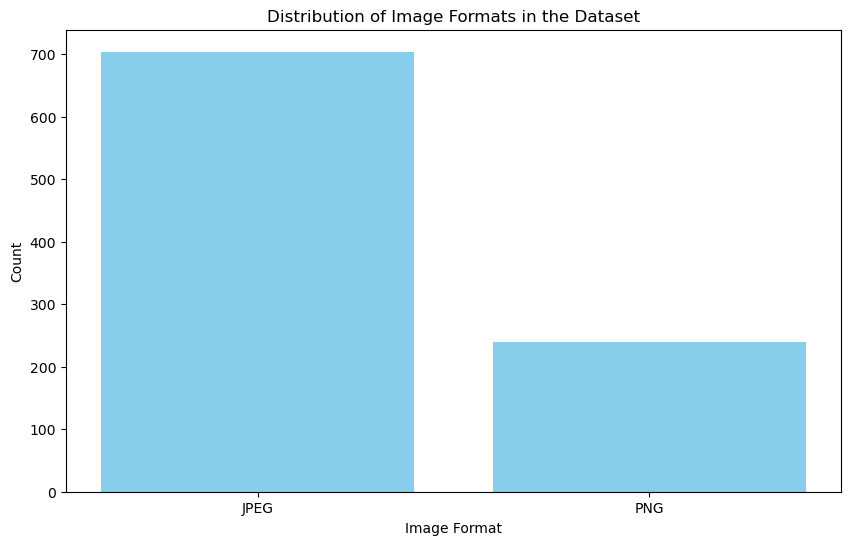

In [8]:
from PIL import Image
import os
import matplotlib.pyplot as plt

# Define the base path to your dataset
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"

# Initialize a dictionary to store image formats
image_formats = {}

# Loop through each category folder (Normal, Osteopenia, Osteoporosis)
for category in ["Normal", "Osteopenia", "Osteoporosis"]:
    category_path = os.path.join(base_path, category)
    for img_name in os.listdir(category_path):
        img_path = os.path.join(category_path, img_name)
        try:
            with Image.open(img_path) as img:
                format_type = img.format
                if format_type not in image_formats:
                    image_formats[format_type] = 0
                image_formats[format_type] += 1
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

# Visualize the image formats in a bar chart
plt.figure(figsize=(10, 6))
plt.bar(image_formats.keys(), image_formats.values(), color='skyblue')
plt.title("Distribution of Image Formats in the Dataset")
plt.xlabel("Image Format")
plt.ylabel("Count")
plt.show()


             Width       Height
count   943.000000   943.000000
mean   1420.566278  1776.349947
std    1341.478586  1257.152101
min     128.000000   256.000000
25%     421.500000   822.000000
50%    1048.000000  1800.000000
75%    2180.000000  2656.000000
max    5320.000000  5320.000000


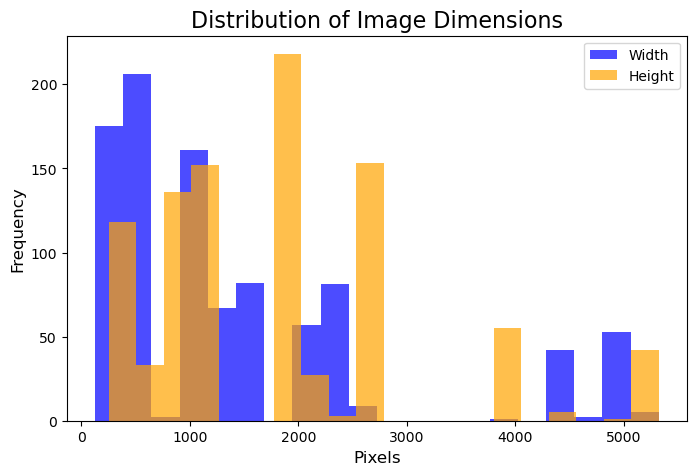

In [9]:
# Get image dimensions for all images
dimensions = []
for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path)
        dimensions.append(img.size)

# Convert to DataFrame for visualization
df_dims = pd.DataFrame(dimensions, columns=["Width", "Height"])
print(df_dims.describe())

# Plot
plt.figure(figsize=(8, 5))
plt.hist(df_dims["Width"], bins=20, alpha=0.7, label="Width", color="blue")
plt.hist(df_dims["Height"], bins=20, alpha=0.7, label="Height", color="orange")
plt.title("Distribution of Image Dimensions", fontsize=16)
plt.xlabel("Pixels", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.legend()
plt.show()

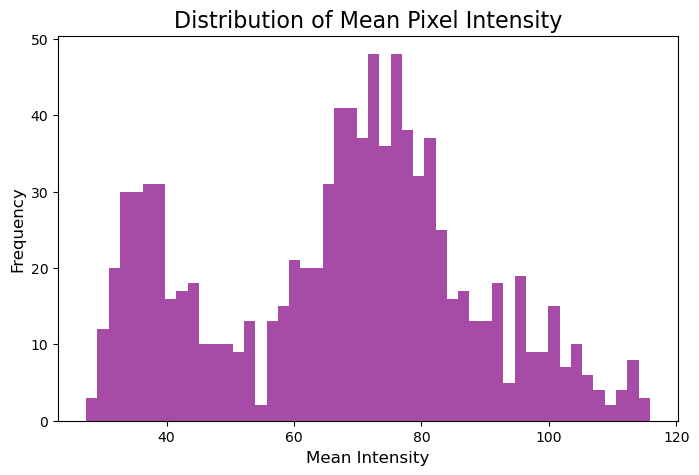

In [10]:
import numpy as np

# Calculate mean intensity for each class
mean_intensities = []

for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        mean_intensities.append(np.array(img).mean())

# Plot histogram of mean intensities
plt.figure(figsize=(8, 5))
plt.hist(mean_intensities, bins=50, color="purple", alpha=0.7)
plt.title("Distribution of Mean Pixel Intensity", fontsize=16)
plt.xlabel("Mean Intensity", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.show()

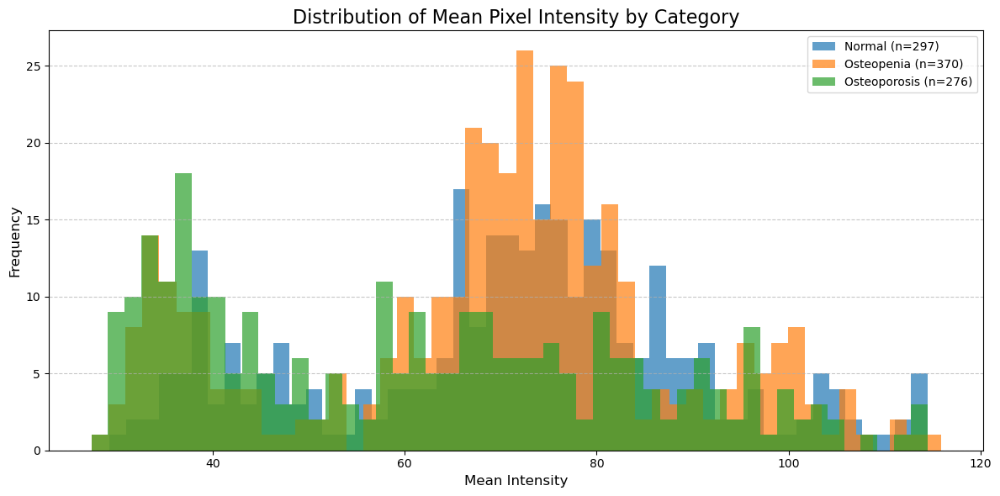

In [11]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Base path to dataset
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"
classes = ["Normal", "Osteopenia", "Osteoporosis"]

# Dictionary to store mean intensities for each category
mean_intensities_by_category = {cls: [] for cls in classes}

# Calculate mean intensity for each class
for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        try:
            img = Image.open(img_path).convert("L")  # Convert to grayscale
            mean_intensity = np.array(img).mean()
            mean_intensities_by_category[cls].append(mean_intensity)
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

# Plot histograms of mean intensities for each category
plt.figure(figsize=(12, 6))
for cls, intensities in mean_intensities_by_category.items():
    plt.hist(intensities, bins=50, alpha=0.7, label=f"{cls} (n={len(intensities)})")

plt.title("Distribution of Mean Pixel Intensity by Category", fontsize=16)
plt.xlabel("Mean Intensity", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

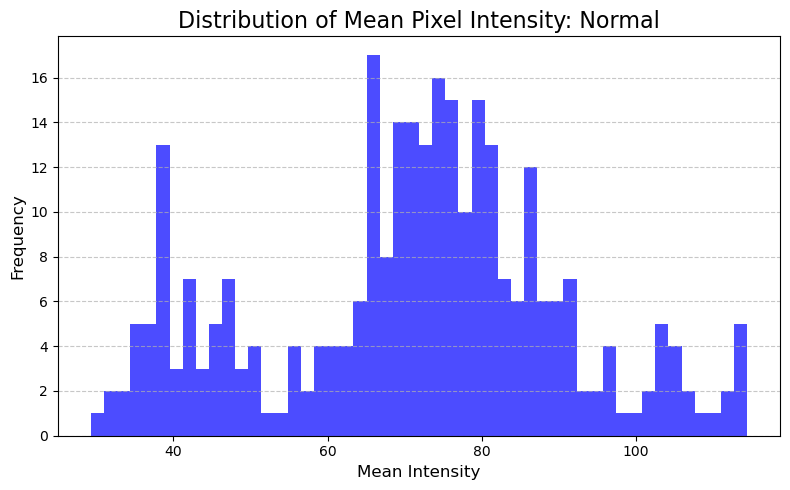

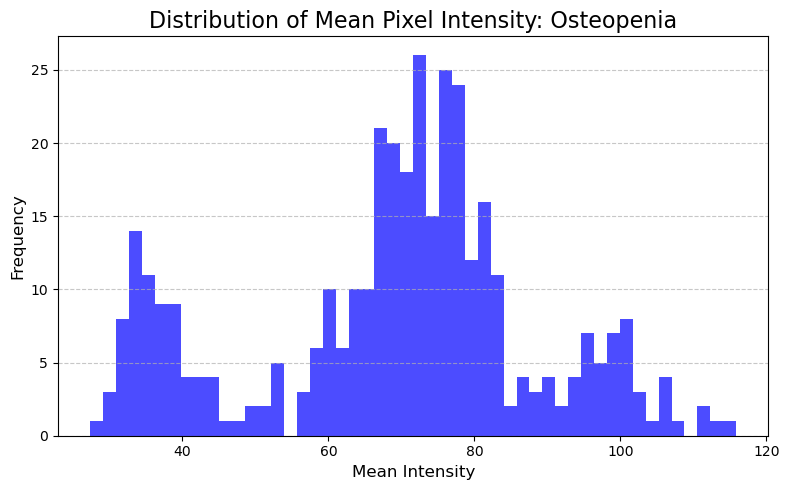

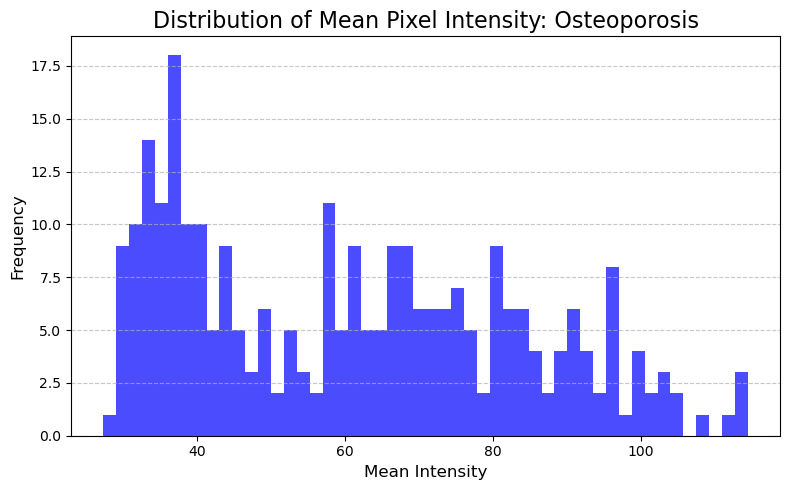

In [12]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Base path to dataset
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"
classes = ["Normal", "Osteopenia", "Osteoporosis"]

# Dictionary to store mean intensities for each category
mean_intensities_by_category = {cls: [] for cls in classes}

# Calculate mean intensity for each class
for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        try:
            img = Image.open(img_path).convert("L")  # Convert to grayscale
            mean_intensity = np.array(img).mean()
            mean_intensities_by_category[cls].append(mean_intensity)
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

# Plot histograms of mean intensities for each category separately
for cls, intensities in mean_intensities_by_category.items():
    plt.figure(figsize=(8, 5))
    plt.hist(intensities, bins=50, alpha=0.7, color="blue")
    plt.title(f"Distribution of Mean Pixel Intensity: {cls}", fontsize=16)
    plt.xlabel("Mean Intensity", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.tight_layout()
    plt.show()

In [39]:
corrupt_images = []

for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        try:
            img = Image.open(img_path)
            img.verify()  # Verify if the image can be opened
        except (IOError, SyntaxError) as e:
            corrupt_images.append(img_path)

print(f"Number of corrupt images: {len(corrupt_images)}")
if corrupt_images:
    print("List of corrupt images:")
    for img in corrupt_images:
        print(f" - {img}")

Number of corrupt images: 0


In [40]:
color_modes = {"Grayscale": 0, "RGB": 0}

for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path)
        if img.mode == "RGB":
            color_modes["RGB"] += 1
        elif img.mode == "L":  # L is grayscale
            color_modes["Grayscale"] += 1

print("Color Modes Distribution:")
for mode, count in color_modes.items():
    print(f" - {mode}: {count} images")

Color Modes Distribution:
 - Grayscale: 102 images
 - RGB: 721 images


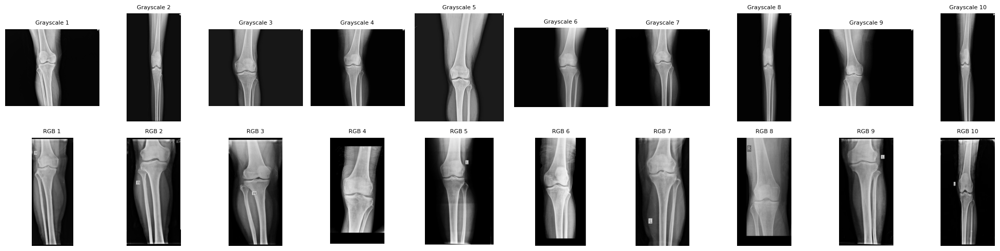

In [13]:
from PIL import Image
import os
import matplotlib.pyplot as plt

# Define the path to your dataset
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"
classes = ["Normal", "Osteopenia", "Osteoporosis"]

# Collect grayscale and RGB images
grayscale_images = []
rgb_images = []

for cls in classes:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        img = Image.open(img_path)
        if img.mode == "L" and len(grayscale_images) < 10:  # Grayscale images
            grayscale_images.append(img)
        elif img.mode == "RGB" and len(rgb_images) < 10:  # RGB images
            rgb_images.append(img)

        # Stop collecting if we have 10 of each
        if len(grayscale_images) >= 10 and len(rgb_images) >= 10:
            break

# Plot 10 grayscale and 10 RGB images side by side
fig, axes = plt.subplots(2, 10, figsize=(20, 5))

for i, (gray_img, rgb_img) in enumerate(zip(grayscale_images, rgb_images)):
    # Grayscale images
    axes[0, i].imshow(gray_img, cmap="gray")
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Grayscale {i+1}", fontsize=8)
    
    # RGB images
    axes[1, i].imshow(rgb_img)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"RGB {i+1}", fontsize=8)

plt.tight_layout()
plt.show()

## Analyze Bone Characteristics

Edge Detection
Highlight structural differences between Normal, Osteopenia, and Osteoporosis bones using edge detection techniques.

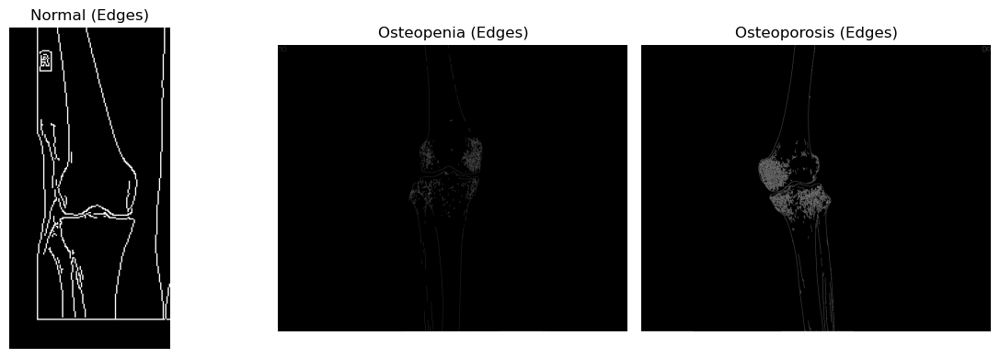

In [22]:
import cv2
import numpy as np

# Apply edge detection
fig, axes = plt.subplots(1, 3, figsize=(12, 4))

for i, cls in enumerate(["Normal", "Osteopenia", "Osteoporosis"]):
    folder_path = os.path.join(base_path, cls)
    img_path = os.path.join(folder_path, os.listdir(folder_path)[10])
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # Read as grayscale
    edges = cv2.Canny(img, 50, 150)  # Canny edge detection
    axes[i].imshow(edges, cmap="gray")
    axes[i].set_title(f"{cls} (Edges)", fontsize=12)
    axes[i].axis("off")

plt.tight_layout()
plt.show()

Use texture analysis (Local Binary Patterns) to understand the differences in texture between normal and abnormal bones.

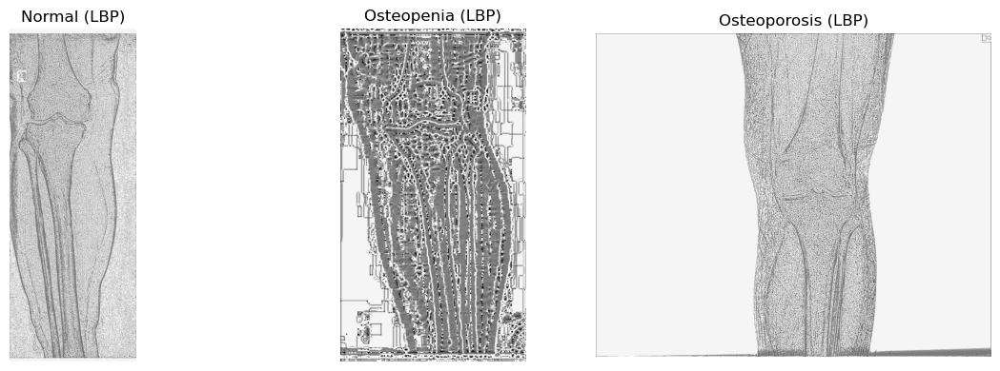

In [23]:
import cv2
from skimage.feature import local_binary_pattern

# Compute Local Binary Pattern (LBP)
radius = 3
n_points = 8 * radius

fig, axes = plt.subplots(1, 3, figsize=(12, 4))

for i, cls in enumerate(["Normal", "Osteopenia", "Osteoporosis"]):
    folder_path = os.path.join(base_path, cls)
    img_path = os.path.join(folder_path, os.listdir(folder_path)[0])
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    axes[i].imshow(lbp, cmap="gray")
    axes[i].set_title(f"{cls} (LBP)", fontsize=12)
    axes[i].axis("off")

plt.tight_layout()
plt.show()

Visualize differences in bone density by normalizing pixel intensities.


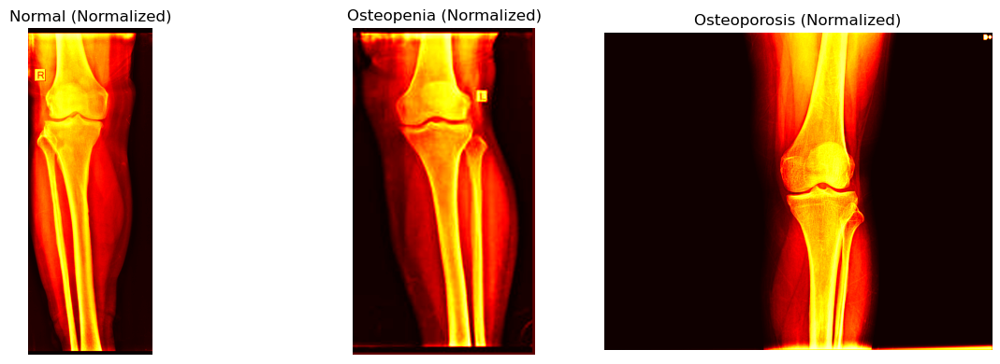

In [24]:
# Normalize pixel values and overlay images
fig, axes = plt.subplots(1, 3, figsize=(12, 4))

for i, cls in enumerate(["Normal", "Osteopenia", "Osteoporosis"]):
    folder_path = os.path.join(base_path, cls)
    img_path = os.path.join(folder_path, os.listdir(folder_path)[0])
    img = Image.open(img_path).convert("L")
    img_normalized = np.array(img) / 255.0  # Normalize to [0, 1]
    axes[i].imshow(img_normalized, cmap="hot")
    axes[i].set_title(f"{cls} (Normalized)", fontsize=12)
    axes[i].axis("off")

plt.tight_layout()
plt.show()

## Duplicate Analysis

Compare Image Hashes
Use the Perceptual Hashing (pHash) algorithm to identify duplicates, even if the images are resized or slightly modified.

In [25]:
# !pip install imagehash

Category-wise Statistics:
Category: Normal
  Duplicates: 33
  Unique Images: 297
Category: Osteopenia
  Duplicates: 2
  Unique Images: 370
Category: Osteoporosis
  Duplicates: 29
  Unique Images: 276

Duplicate Distribution:
  64 images have 1 duplicates.


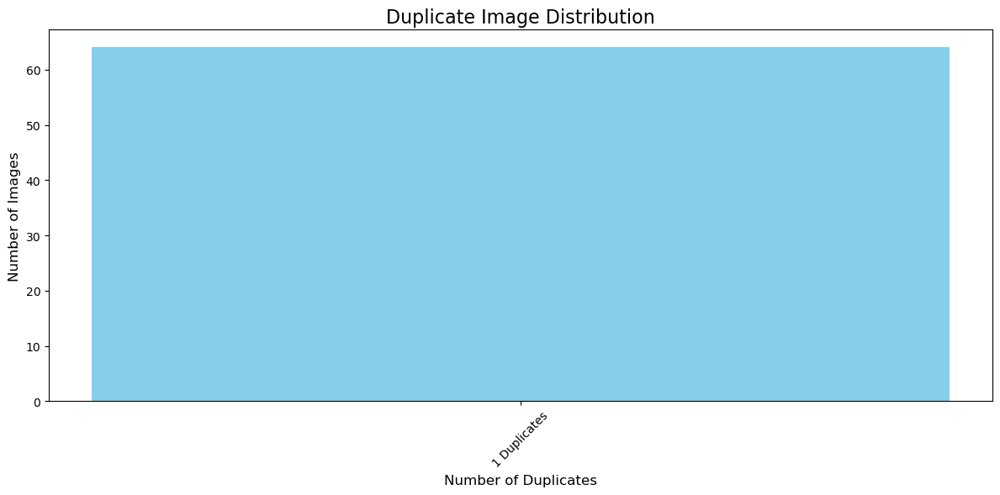


Displaying first 5 duplicate pairs:


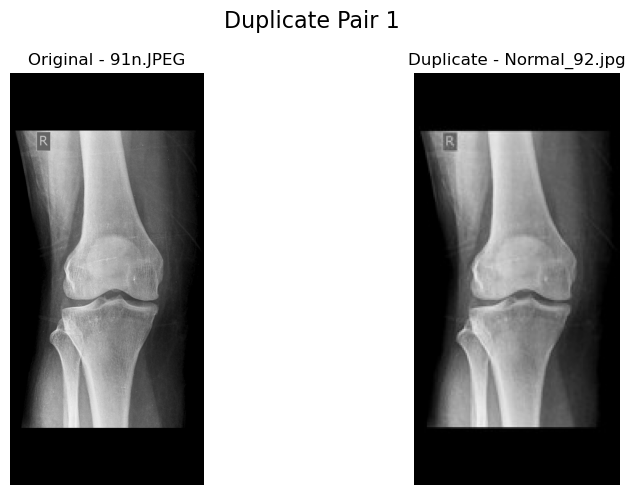

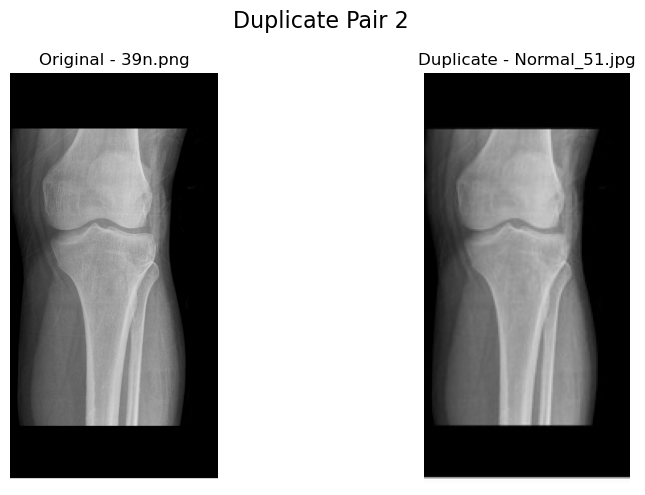

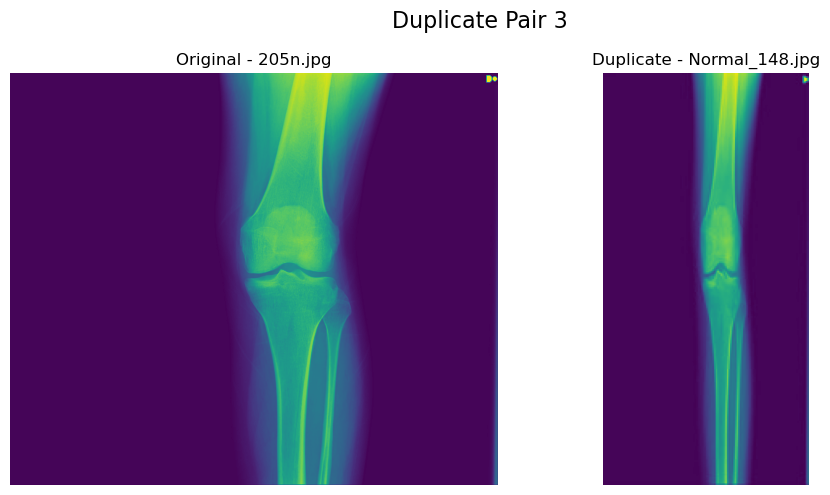

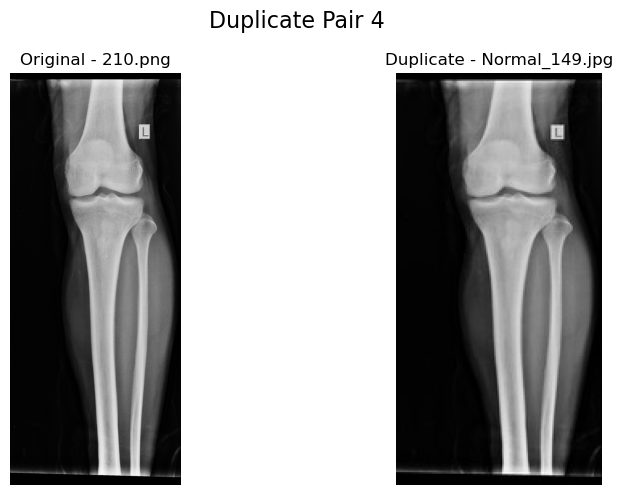

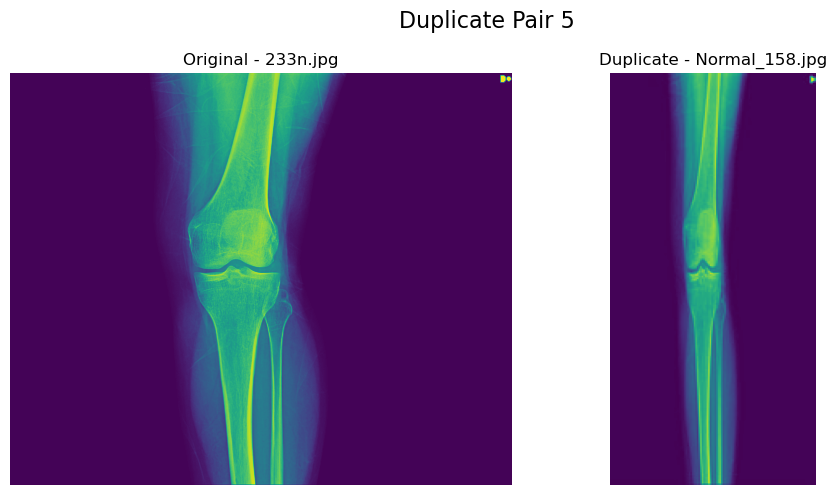

In [27]:
import imagehash
from PIL import Image
import os
import matplotlib.pyplot as plt
from collections import defaultdict

# Base path to dataset
base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"

# Categories to process
categories = ["Normal", "Osteopenia", "Osteoporosis"]

# Compute hashes and find duplicates
hashes = {}
duplicates = defaultdict(list)  # Dictionary to store duplicates by their original hash
category_stats = {cls: {"duplicates": 0, "unique": 0} for cls in categories}

for cls in categories:
    folder_path = os.path.join(base_path, cls)
    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)
        try:
            img = Image.open(img_path)
            img_hash = imagehash.phash(img)  # Compute perceptual hash
            if img_hash in hashes:
                duplicates[img_hash].append(img_path)  # Group duplicates by hash
                category_stats[cls]["duplicates"] += 1
            else:
                hashes[img_hash] = img_path
                category_stats[cls]["unique"] += 1
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

# Output the statistics for each category
print("Category-wise Statistics:")
for cls, stats in category_stats.items():
    print(f"Category: {cls}")
    print(f"  Duplicates: {stats['duplicates']}")
    print(f"  Unique Images: {stats['unique']}")

# Analyze duplicate counts for detailed distribution (1, 2, 3, ... duplicates)
duplicate_distribution = defaultdict(int)
for original_img, duplicate_imgs in duplicates.items():
    duplicate_distribution[len(duplicate_imgs)] += 1

# Print duplicate distribution
print("\nDuplicate Distribution:")
for num_duplicates, num_images in sorted(duplicate_distribution.items()):
    print(f"  {num_images} images have {num_duplicates} duplicates.")

# Visualize the distribution as a bar chart
plt.figure(figsize=(12, 6))
plt.bar(
    [f"{k} Duplicates" for k in sorted(duplicate_distribution.keys())],
    [duplicate_distribution[k] for k in sorted(duplicate_distribution.keys())],
    color="skyblue",
)
plt.title("Duplicate Image Distribution", fontsize=16)
plt.ylabel("Number of Images", fontsize=12)
plt.xlabel("Number of Duplicates", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Display the first 5 duplicate pairs
def display_duplicates(duplicate_pairs, max_pairs=5):
    pairs_shown = 0
    for img_hash, dup_list in duplicate_pairs.items():
        if pairs_shown >= max_pairs:
            break
        original_img = hashes[img_hash]
        for duplicate_img in dup_list[:max_pairs]:
            try:
                img1 = Image.open(original_img)
                img2 = Image.open(duplicate_img)
                
                fig, axes = plt.subplots(1, 2, figsize=(10, 5))
                axes[0].imshow(img1)
                axes[0].set_title(f"Original - {os.path.basename(original_img)}")
                axes[0].axis("off")

                axes[1].imshow(img2)
                axes[1].set_title(f"Duplicate - {os.path.basename(duplicate_img)}")
                axes[1].axis("off")

                plt.suptitle(f"Duplicate Pair {pairs_shown + 1}", fontsize=16)
                plt.tight_layout()
                plt.show()
                
                pairs_shown += 1
                if pairs_shown >= max_pairs:
                    break
            except Exception as e:
                print(f"Error displaying duplicate pair: {e}")

# Display first 5 duplicate pairs
print("\nDisplaying first 5 duplicate pairs:")
display_duplicates(duplicates, max_pairs=5)

In [41]:
# import os
# from PIL import Image
# import imagehash
# from collections import defaultdict

# # Base path to dataset
# base_path = "/Users/gideonbonwitt/Documents/Msc/osteoporosis_project/Data/no_duplicate_data"
# categories = ["Normal", "Osteopenia", "Osteoporosis"]

# # Initialize dictionary to track hashes
# hashes = {}
# duplicate_images = defaultdict(list)

# # Identify duplicates
# for category in categories:
#     folder_path = os.path.join(base_path, category)
#     for img_name in os.listdir(folder_path):
#         img_path = os.path.join(folder_path, img_name)
#         try:
#             img = Image.open(img_path)
#             img_hash = imagehash.phash(img)
#             if img_hash in hashes:
#                 duplicate_images[img_hash].append(img_path)
#             else:
#                 hashes[img_hash] = img_path
#         except Exception as e:
#             print(f"Error processing {img_path}: {e}")

# # Remove duplicates
# for img_hash, duplicates in duplicate_images.items():
#     # Keep the first occurrence and remove the rest
#     for dup_img in duplicates:
#         try:
#             os.remove(dup_img)
#             print(f"Removed duplicate: {dup_img}")
#         except Exception as e:
#             print(f"Error removing {dup_img}: {e}")

# print("Duplicate removal completed.")

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_xray(image_path):
    """
    Processes an X-ray image to emphasize bone density.

    Args:
        image_path (str): Path to the X-ray image.

    Returns:
        None: Displays the processed images.
    """
    
    # Read and convert the image to grayscale
    img = Image.open(image_path).convert("L")
    img_array = np.array(img)

    # Apply Gaussian Blur first
    blurred_img = cv2.GaussianBlur(img_array, (5, 5), 0)

    # Apply CLAHE for contrast enhancement after blurring
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_img = clahe.apply(blurred_img)

    # Apply Canny Edge Detection with adjusted thresholds
    edges = cv2.Canny(clahe_img, 100, 200)  # Experiment with these values

    # Apply pseudo-color mapping
    pseudo_color_img = cv2.applyColorMap(cv2.convertScaleAbs(clahe_img), cv2.COLORMAP_JET)

    # Plot results
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 5, 1)
    plt.imshow(img_array, cmap="gray")
    plt.title("Original X-ray")
    plt.axis("off")

    plt.subplot(1, 5, 2)
    plt.imshow(blurred_img, cmap="gray")
    plt.title("Gaussian Blur")
    plt.axis("off")

    plt.subplot(1, 5, 3)
    plt.imshow(clahe_img, cmap="gray")
    plt.title("Contrast Enhanced (CLAHE)")
    plt.axis("off")

    plt.subplot(1, 5, 4)
    plt.imshow(edges, cmap="gray")
    plt.title("Edge Detection (Canny)")
    plt.axis("off")

    plt.subplot(1, 5, 5)
    plt.imshow(pseudo_color_img)
    plt.title("Pseudo-Color Mapping")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


Processing 10 images from category: Normal
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/Normal_171.jpg


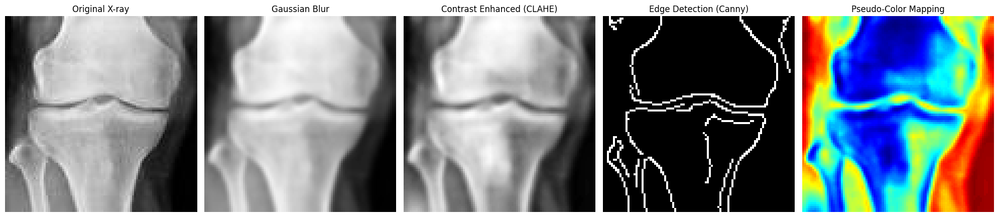

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/91n.JPEG


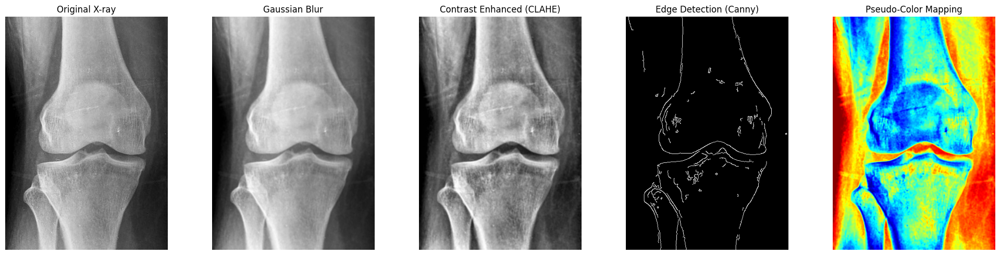

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/2.jpg


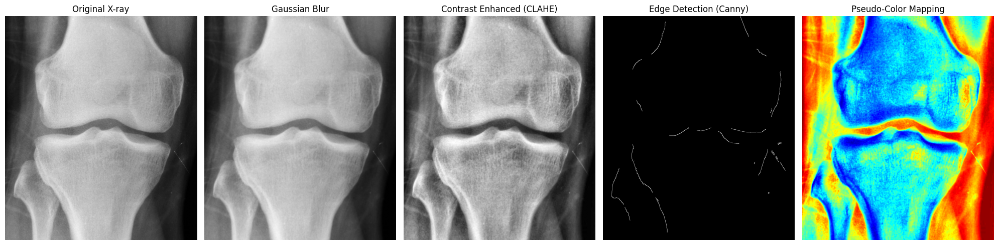

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/160n.png


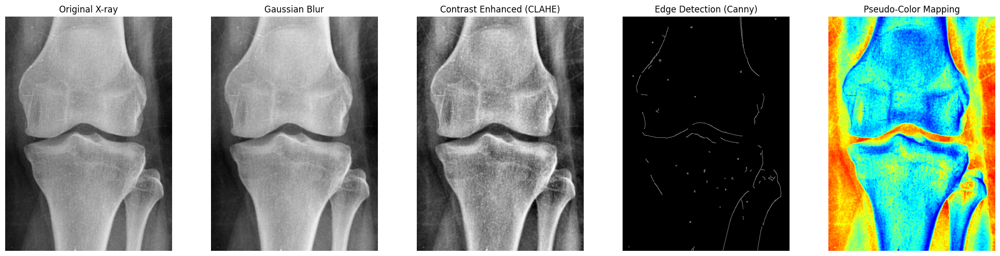

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/300n.jpg


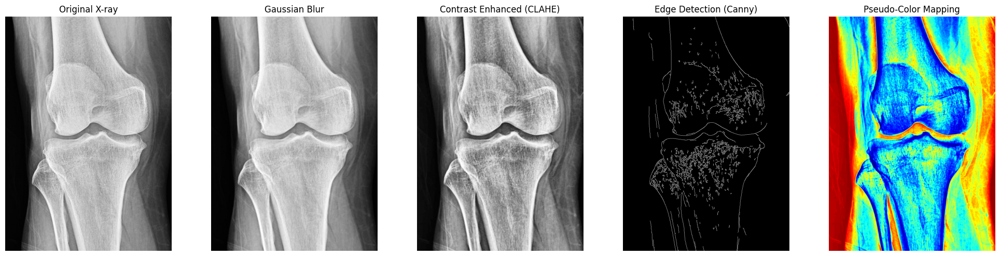

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/256n.png


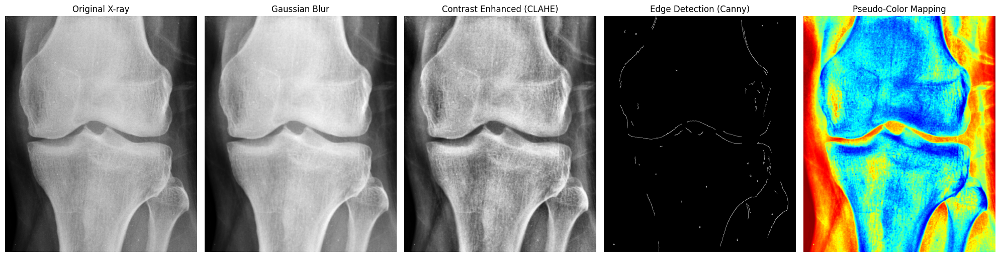

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/131.jpg


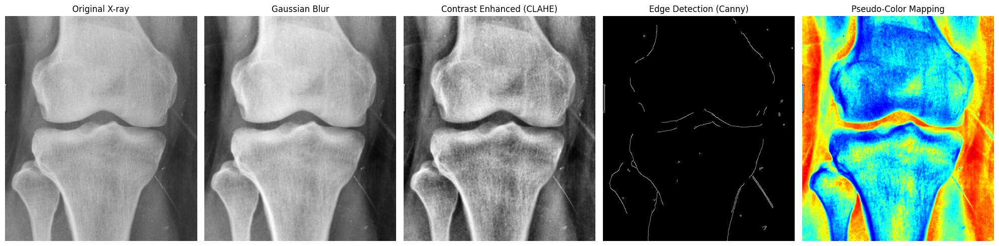

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/Normal_134.jpg


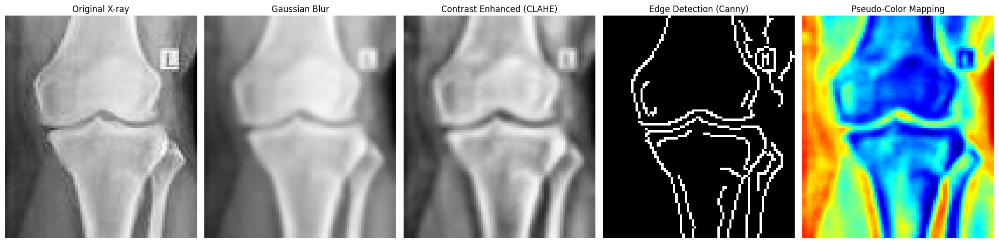

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/123.png


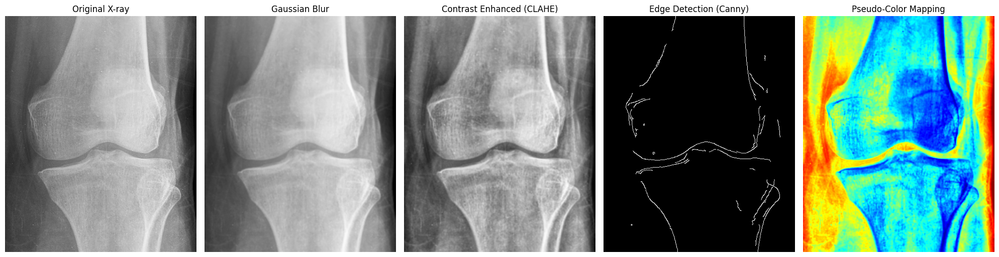

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/45.jpg


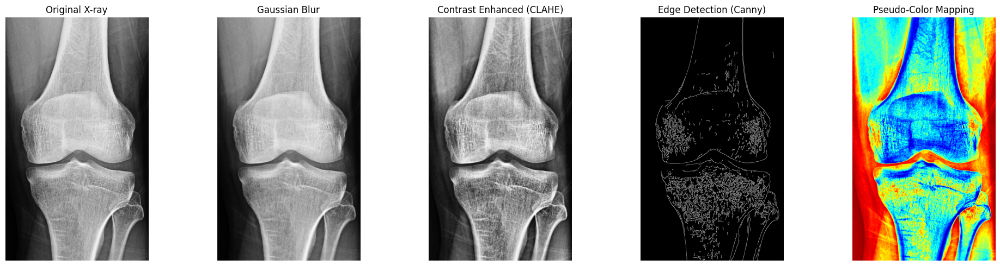


Processing 10 images from category: Osteopenia
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP17_L.jpg


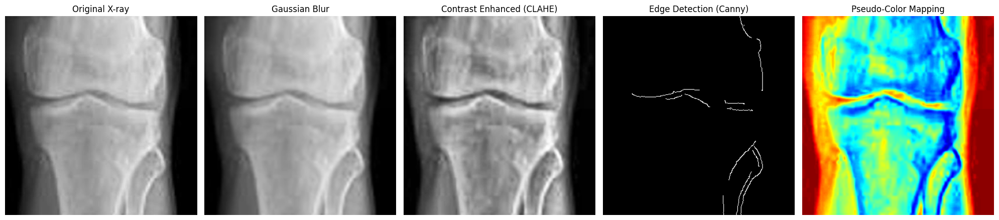

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 162.jpg


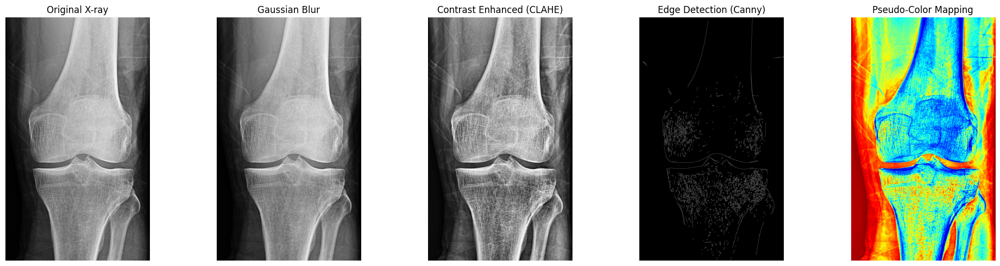

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP16_L.jpg


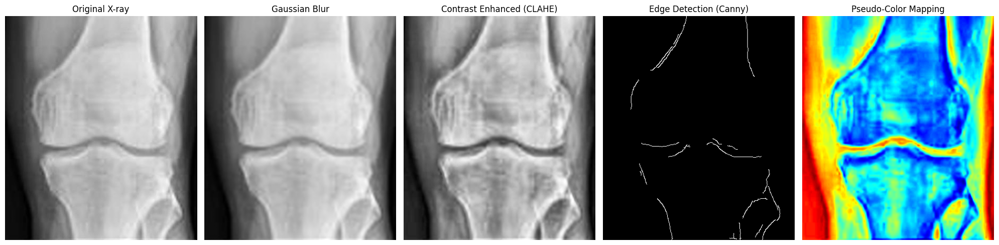

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 13.jpg


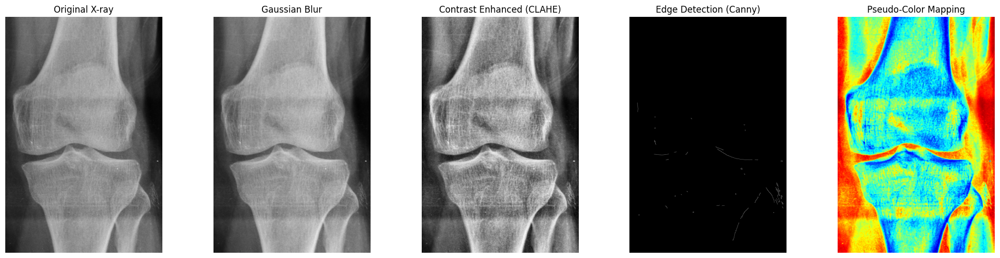

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP56.jpg


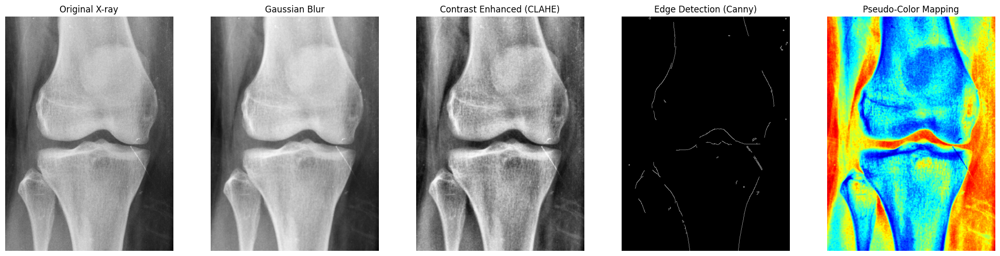

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 152.jpg


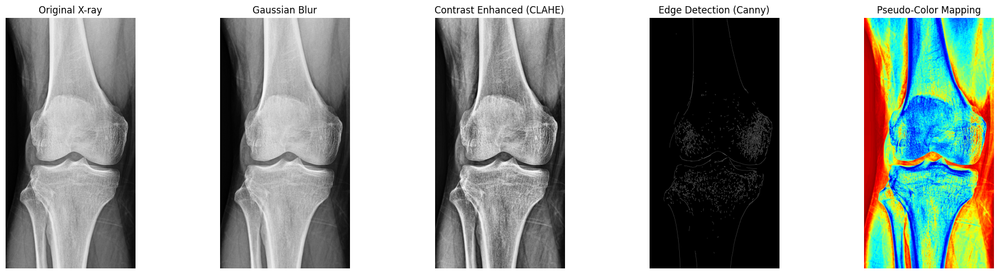

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 143.jpg


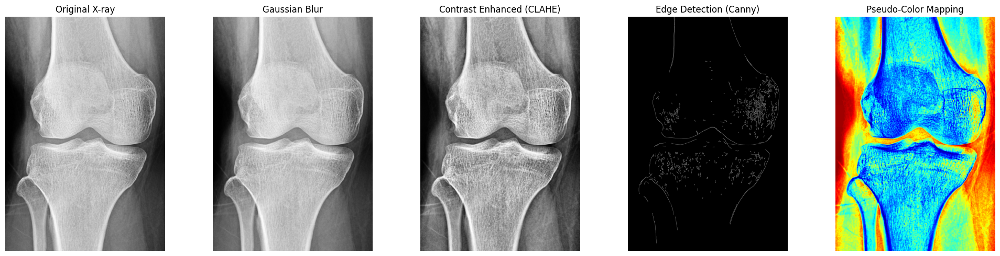

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 136.jpg


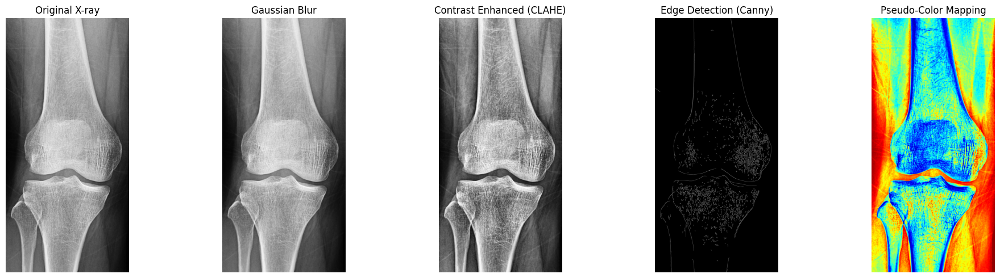

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP14_R.jpg


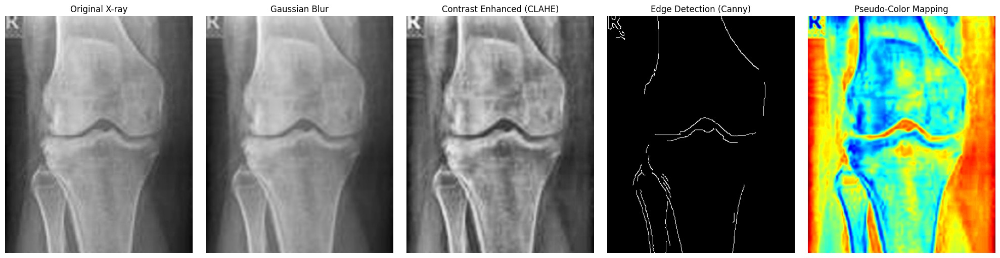

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP15.JPEG


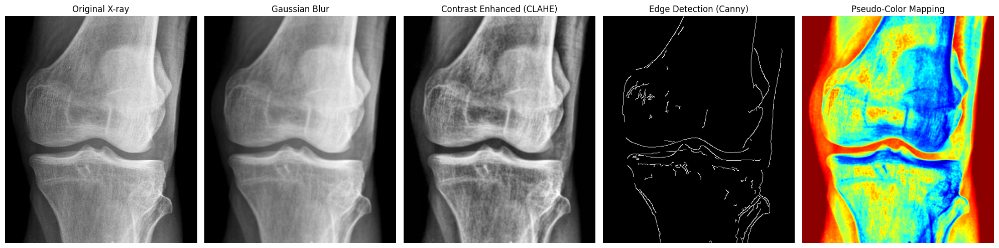


Processing 10 images from category: Osteoporosis
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/Osteoporosis_86.jpg


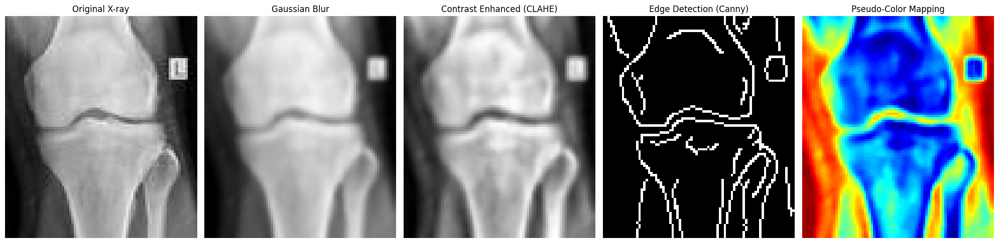

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/264.png


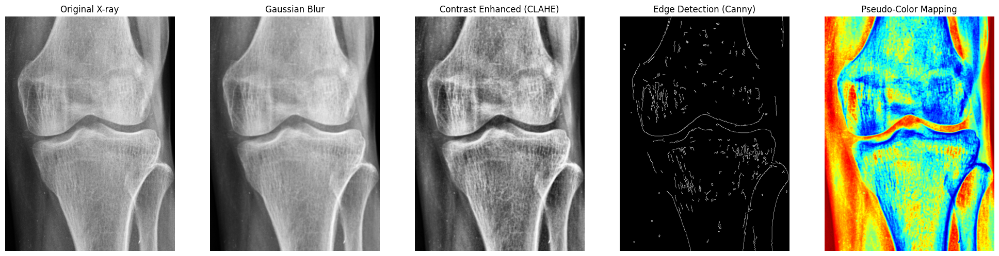

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/Osteoporosis_136.jpg


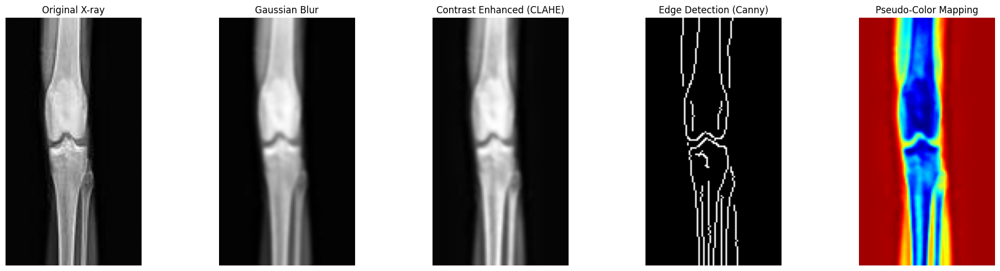

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/177.jpg


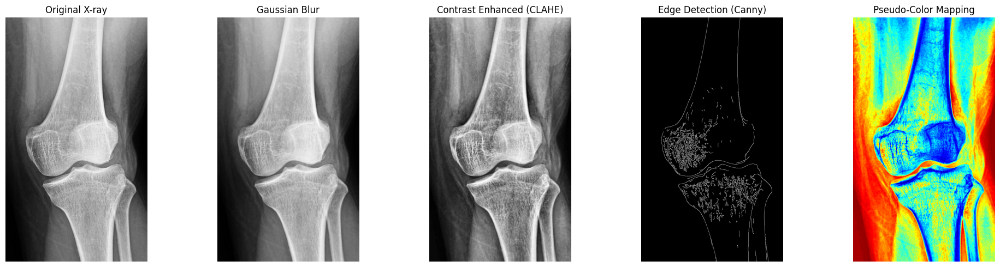

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/102.png


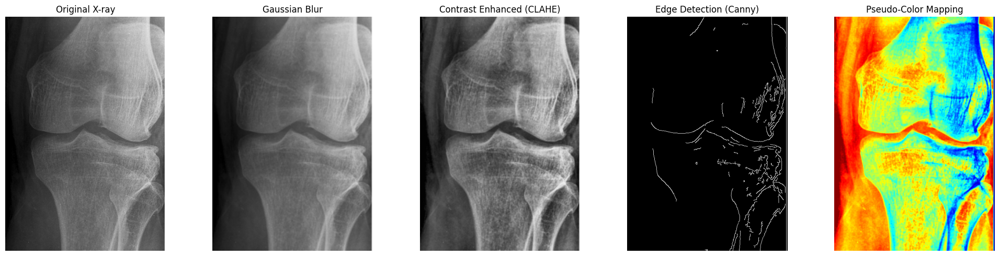

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/Osteoporosis_27.jpg


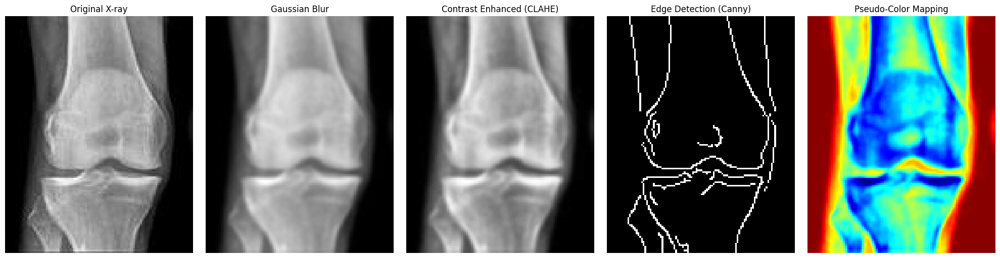

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/263.png


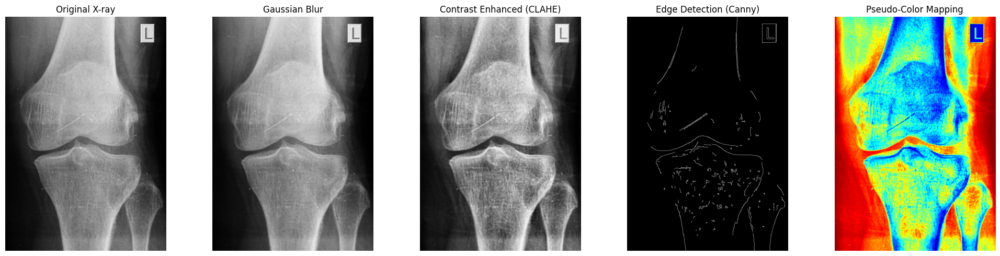

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/296.jpg


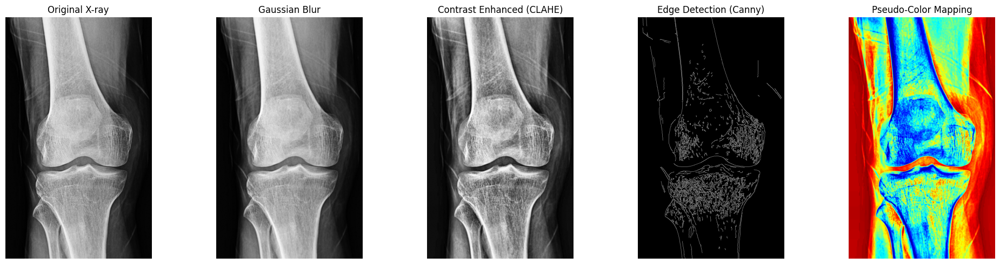

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/193.jpg


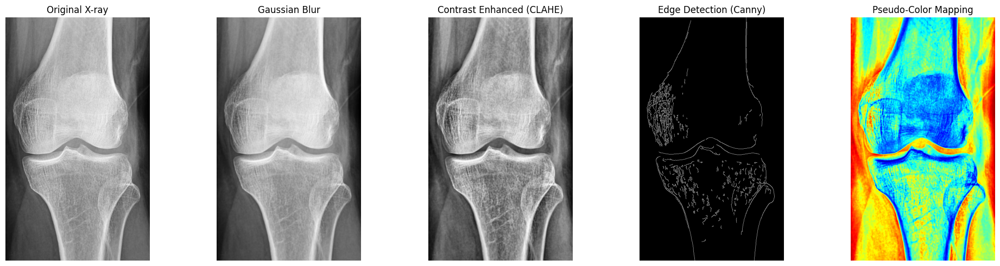

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/24.png


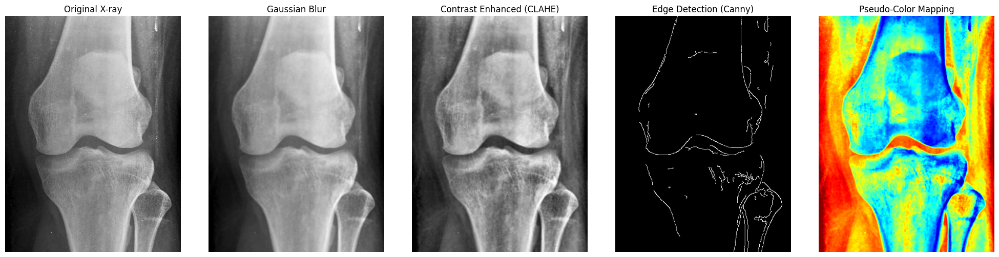

In [17]:
import os
import random

# Define the folder path
base_path = "/Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data"

# Categories to process
categories = ["Normal", "Osteopenia", "Osteoporosis"]

# Function to process multiple images
def process_multiple_images(base_path, categories, num_images=3):
    for category in categories:
        category_path = os.path.join(base_path, category)

        # Ensure the folder exists and contains images
        if not os.path.exists(category_path) or not os.listdir(category_path):
            print(f"No images found in {category_path}. Skipping...")
            continue

        # Get all image files in the category
        image_files = [
            os.path.join(category_path, f)
            for f in os.listdir(category_path)
            if f.lower().endswith((".png", ".jpg", ".jpeg"))
        ]

        # Randomly select images to process
        selected_images = random.sample(image_files, min(num_images, len(image_files)))

        print(f"\nProcessing {len(selected_images)} images from category: {category}")

        # Process each selected image
        for image_path in selected_images:
            print(f"Processing image: {image_path}")
            process_xray(image_path)

# Call the function
process_multiple_images(base_path, categories, num_images=10)

In [19]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def process_xray_adaptive(image_path):
    # Read and convert the image to grayscale
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Measure sharpness using the variance of the Laplacian
    sharpness = cv2.Laplacian(img, cv2.CV_64F).var()
    print(f"Sharpness Score: {sharpness}")

    if sharpness > 500:  # High sharpness
        print("High sharpness detected: Reducing enhancement.")
        # Skip Gaussian blur and use a low CLAHE clip limit
        clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(8, 8))
        enhanced_img = clahe.apply(img)
        edges = cv2.Canny(enhanced_img, 100, 200)  # Adjust thresholds for high-sharpness edges
    else:  # Low sharpness
        print("Low sharpness detected: Applying additional preprocessing.")
        # Apply Gaussian blur to reduce noise, then CLAHE with a higher clip limit
        blurred_img = cv2.GaussianBlur(img, (5, 5), 0)
        clahe = cv2.createCLAHE(clipLimit=2.5, tileGridSize=(8, 8))
        enhanced_img = clahe.apply(blurred_img)
        edges = cv2.Canny(enhanced_img, 50, 150)  # Adjust thresholds for low-sharpness edges

    # Apply pseudo-color mapping
    pseudo_color_img = cv2.applyColorMap(cv2.convertScaleAbs(enhanced_img), cv2.COLORMAP_JET)

    # Display results
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 5, 1)
    plt.imshow(img, cmap="gray")
    plt.title("Original X-ray")
    plt.axis("off")

    plt.subplot(1, 5, 2)
    if sharpness <= 500:
        plt.imshow(blurred_img, cmap="gray")
        plt.title("Blurred Image")
    else:
        plt.imshow(img, cmap="gray")
        plt.title("Original (No Blur)")
    plt.axis("off")

    plt.subplot(1, 5, 3)
    plt.imshow(enhanced_img, cmap="gray")
    plt.title("Enhanced (CLAHE)")
    plt.axis("off")

    plt.subplot(1, 5, 4)
    plt.imshow(edges, cmap="gray")
    plt.title("Edge Detection (Canny)")
    plt.axis("off")

    plt.subplot(1, 5, 5)
    plt.imshow(pseudo_color_img)
    plt.title("Pseudo-Color Mapping")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


Processing 10 images from category: Normal
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/315n.jpg
Sharpness Score: 18.767095212655956
Low sharpness detected: Applying additional preprocessing.


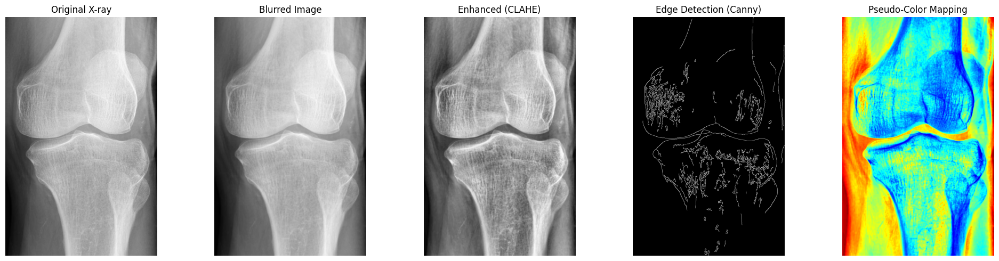

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/Normal_34.jpg
Sharpness Score: 632.4238053819444
High sharpness detected: Reducing enhancement.


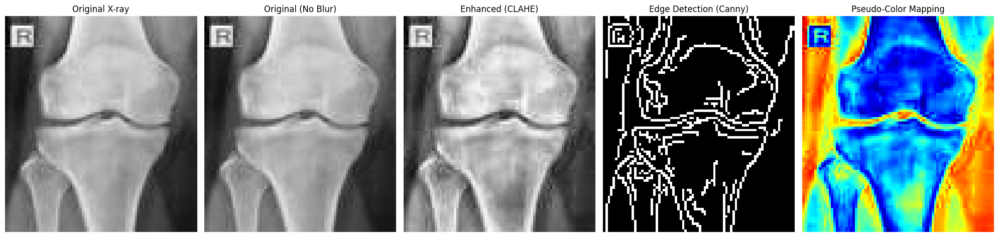

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/30nn.JPEG
Sharpness Score: 174.93747841051564
Low sharpness detected: Applying additional preprocessing.


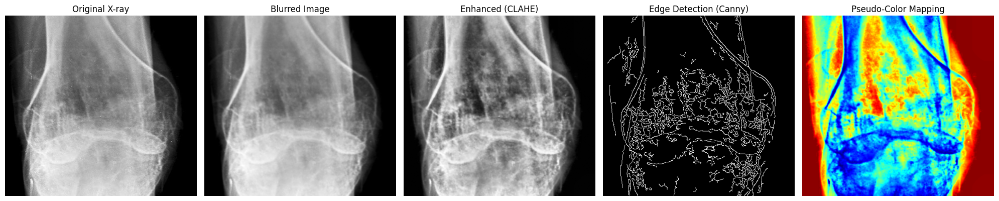

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/N13.jpg
Sharpness Score: 25.475315099265426
Low sharpness detected: Applying additional preprocessing.


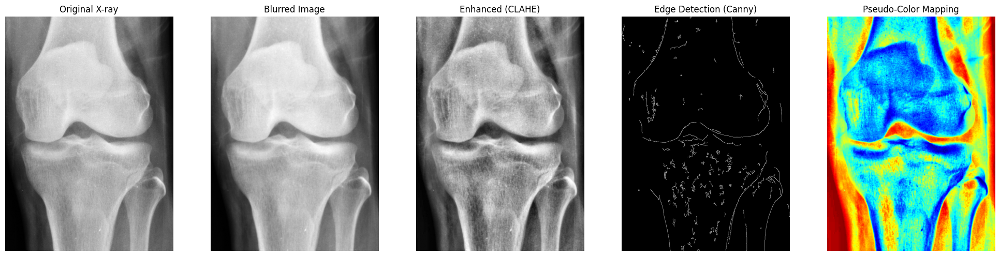

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/13.png
Sharpness Score: 107.83663053758139
Low sharpness detected: Applying additional preprocessing.


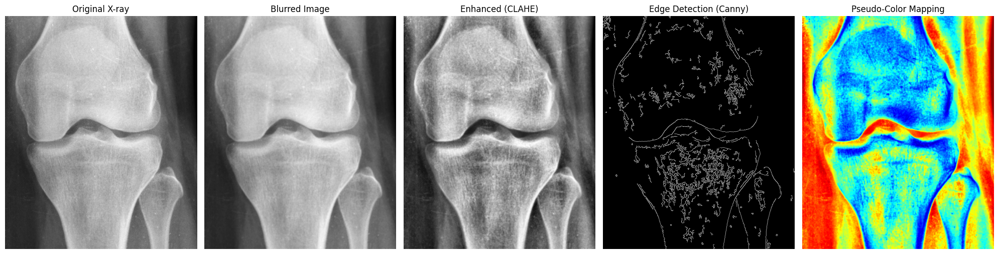

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/Normal_168.jpg
Sharpness Score: 328.3164890959971
Low sharpness detected: Applying additional preprocessing.


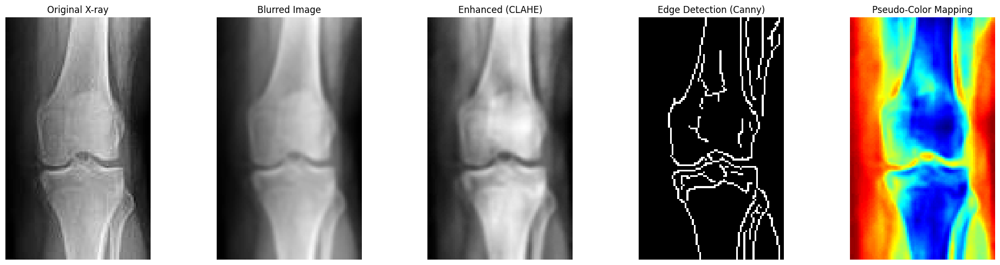

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/17nn.jpg
Sharpness Score: 94.19934590639599
Low sharpness detected: Applying additional preprocessing.


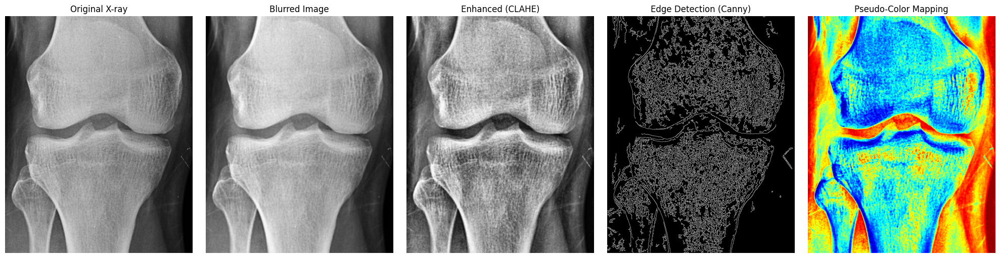

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/Normal_139.jpg
Sharpness Score: 301.30503139500297
Low sharpness detected: Applying additional preprocessing.


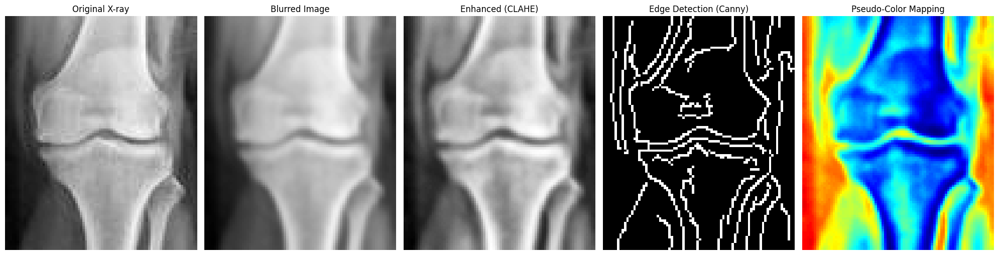

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/292n.jpg
Sharpness Score: 20.566642973434366
Low sharpness detected: Applying additional preprocessing.


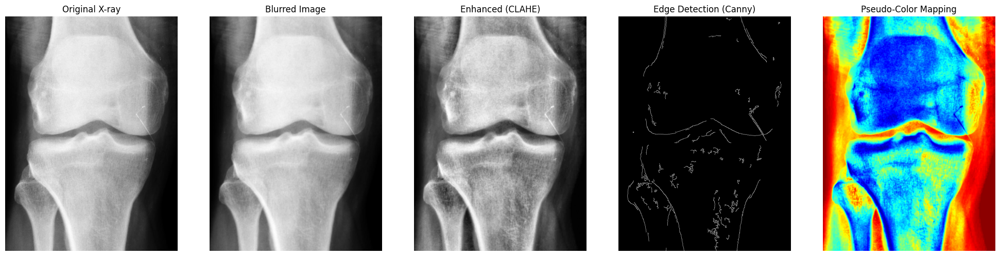

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Normal/45.jpg
Sharpness Score: 126.52809000103356
Low sharpness detected: Applying additional preprocessing.


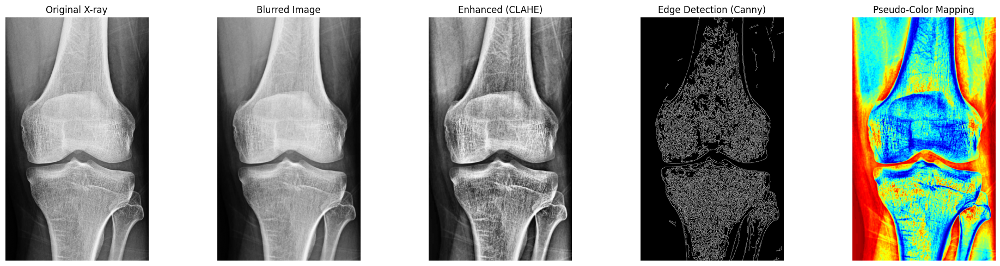


Processing 10 images from category: Osteopenia
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP16_R.jpg
Sharpness Score: 7.504533780848794
Low sharpness detected: Applying additional preprocessing.


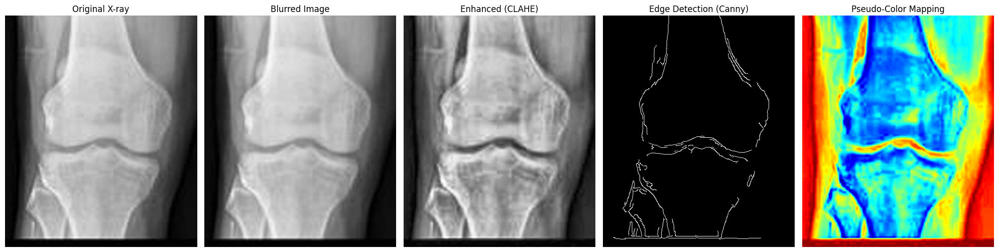

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP29_L.jpg
Sharpness Score: 8.743350437589676
Low sharpness detected: Applying additional preprocessing.


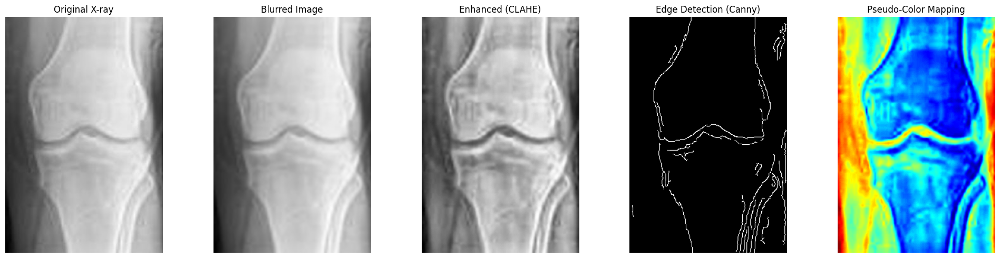

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 163.jpg
Sharpness Score: 22.458985114325536
Low sharpness detected: Applying additional preprocessing.


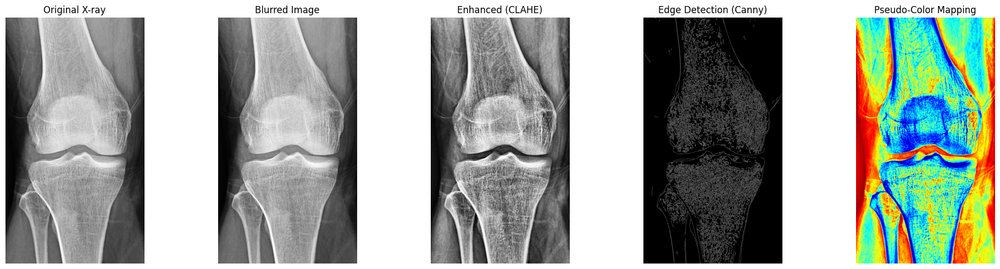

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 137.jpg
Sharpness Score: 14.241805349520249
Low sharpness detected: Applying additional preprocessing.


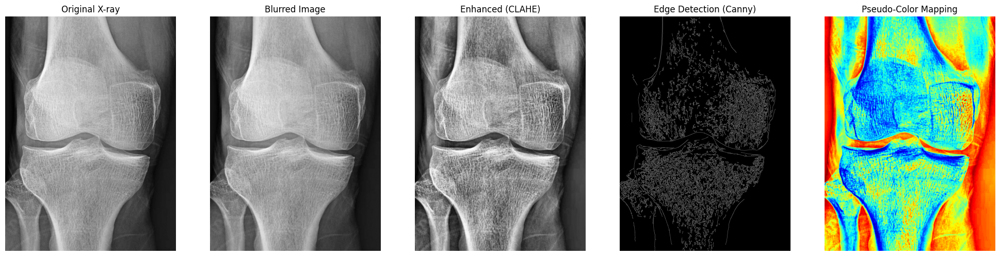

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 172.jpg
Sharpness Score: 13.617445213154518
Low sharpness detected: Applying additional preprocessing.


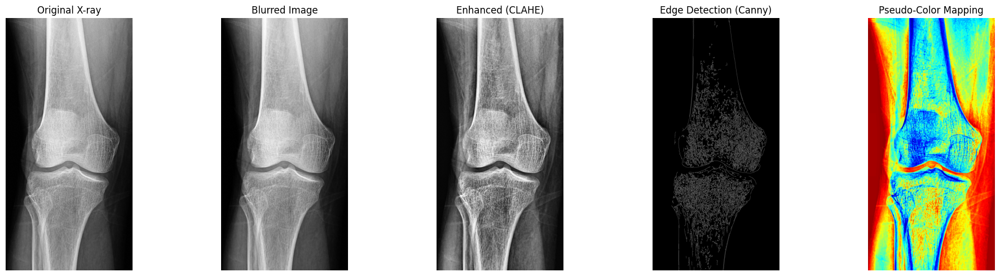

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 181.jpg
Sharpness Score: 11.666679103368638
Low sharpness detected: Applying additional preprocessing.


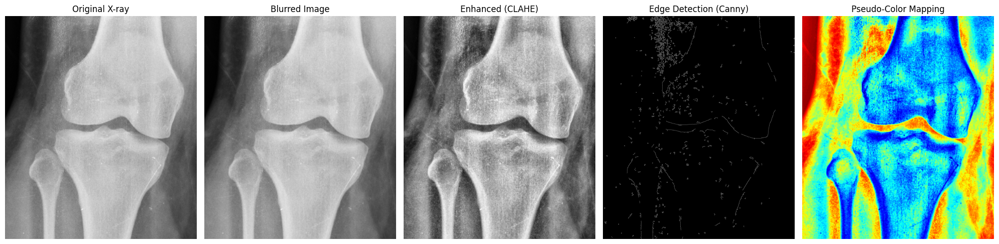

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/Osteopenia 125.jpg
Sharpness Score: 17.344329600619112
Low sharpness detected: Applying additional preprocessing.


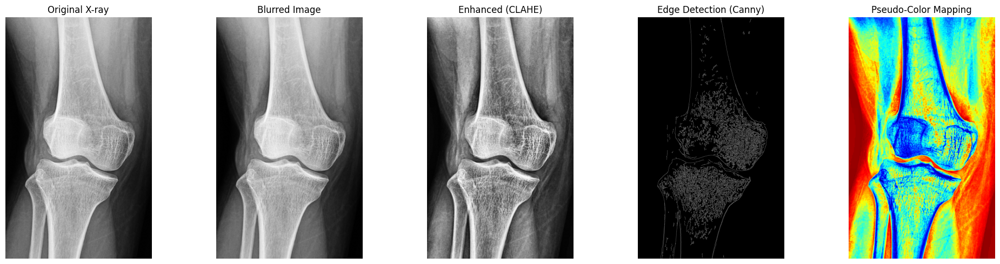

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP64.jpg
Sharpness Score: 79.02052298395397
Low sharpness detected: Applying additional preprocessing.


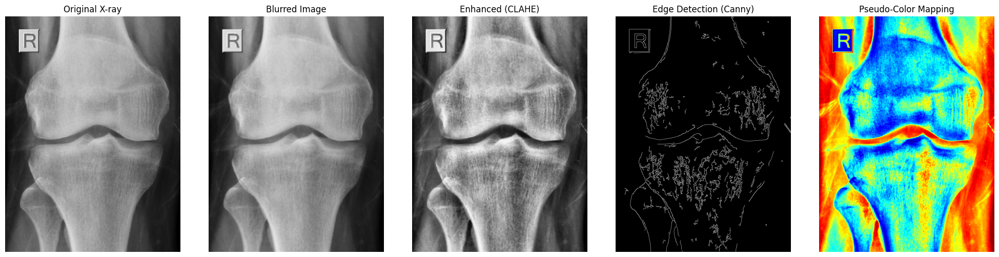

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP83.jpg
Sharpness Score: 94.42151349617464
Low sharpness detected: Applying additional preprocessing.


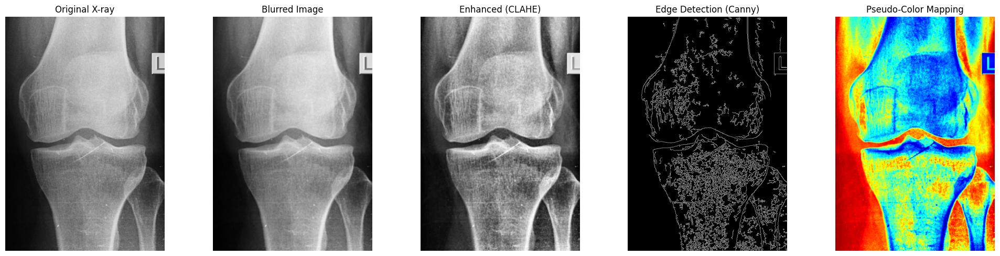

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteopenia/OP67_R.jpg
Sharpness Score: 6.57964382022898
Low sharpness detected: Applying additional preprocessing.


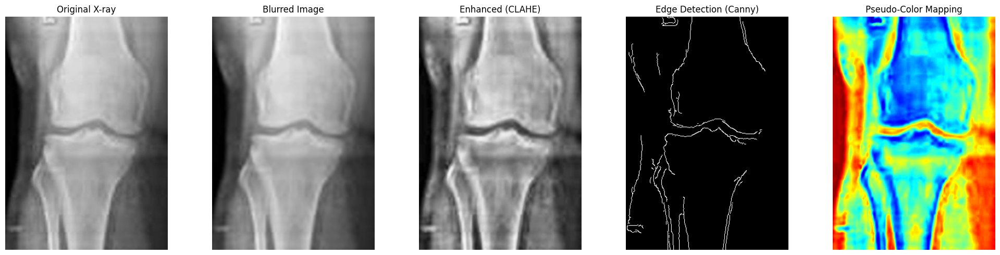


Processing 10 images from category: Osteoporosis
Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/248.jpg
Sharpness Score: 61.85054981194308
Low sharpness detected: Applying additional preprocessing.


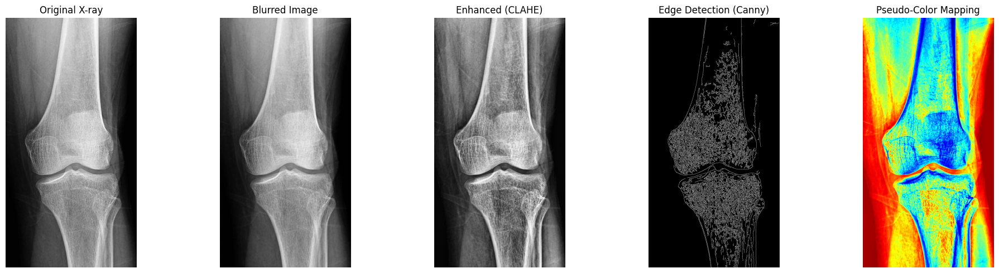

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/124.JPEG
Sharpness Score: 284.3243372472998
Low sharpness detected: Applying additional preprocessing.


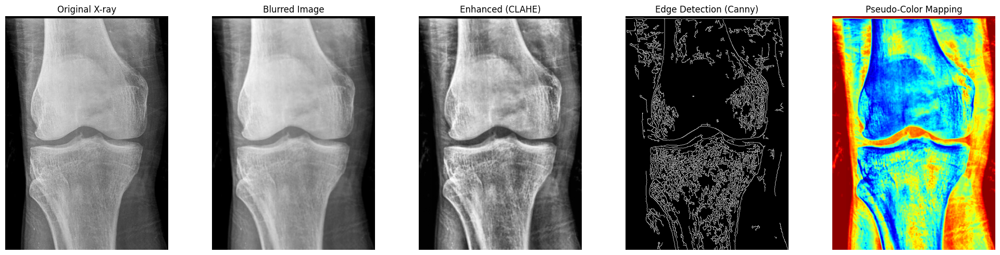

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/111.png
Sharpness Score: 368.03961638792765
Low sharpness detected: Applying additional preprocessing.


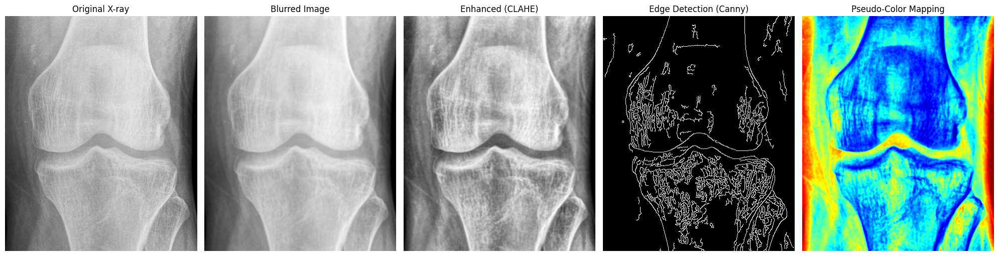

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/203.jpg
Sharpness Score: 104.77810993893543
Low sharpness detected: Applying additional preprocessing.


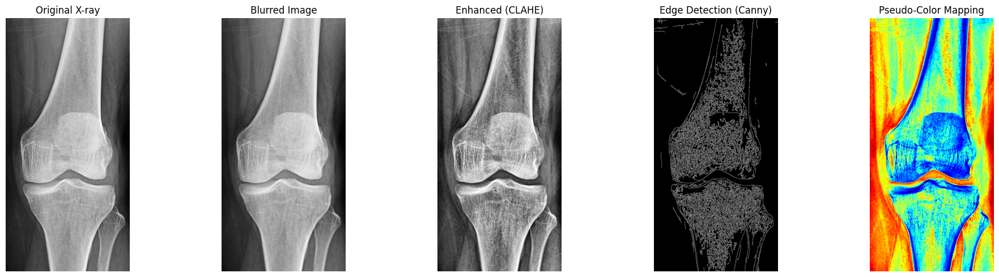

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/171.jpg
Sharpness Score: 134.00398269798808
Low sharpness detected: Applying additional preprocessing.


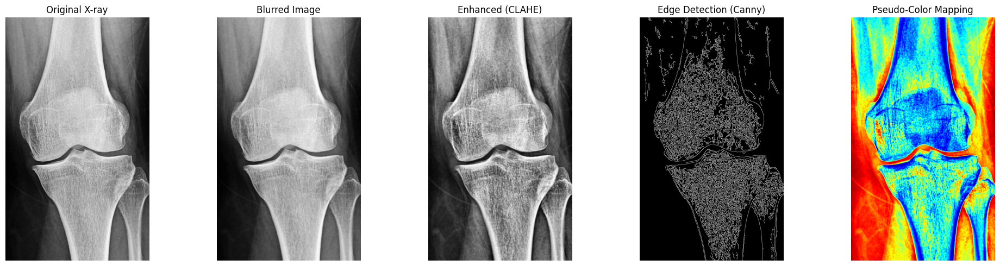

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/127.JPEG
Sharpness Score: 85.96776155907804
Low sharpness detected: Applying additional preprocessing.


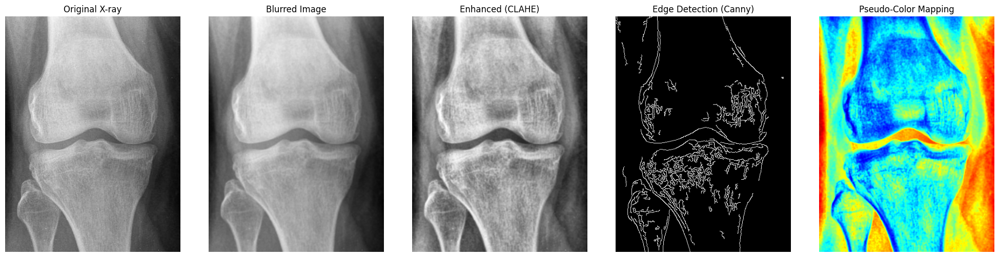

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/OS5.JPEG
Sharpness Score: 135.98283478899833
Low sharpness detected: Applying additional preprocessing.


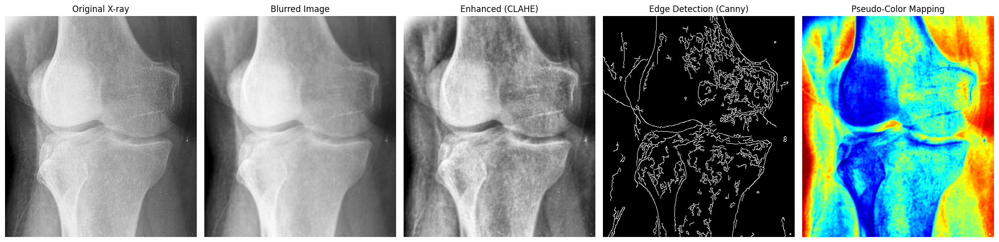

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/OS20.jpg
Sharpness Score: 68.01388499341685
Low sharpness detected: Applying additional preprocessing.


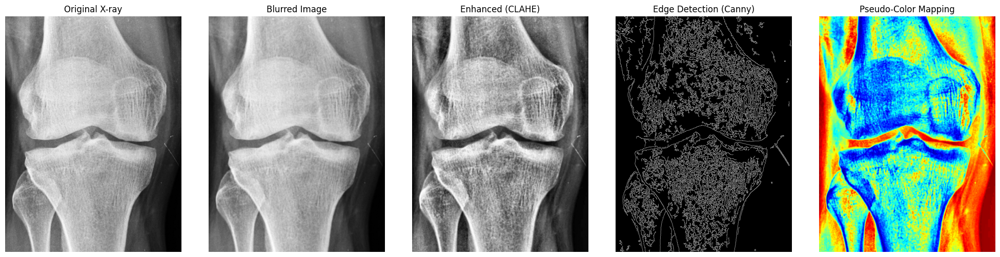

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/Osteoporosis_148.jpg
Sharpness Score: 694.6866117067843
High sharpness detected: Reducing enhancement.


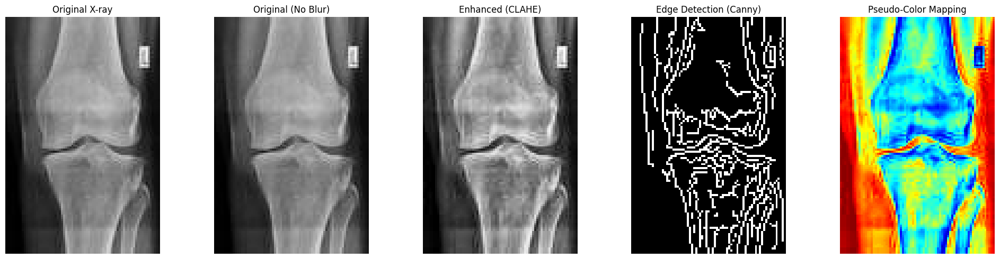

Processing image: /Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data/Osteoporosis/264.png
Sharpness Score: 194.64192071701677
Low sharpness detected: Applying additional preprocessing.


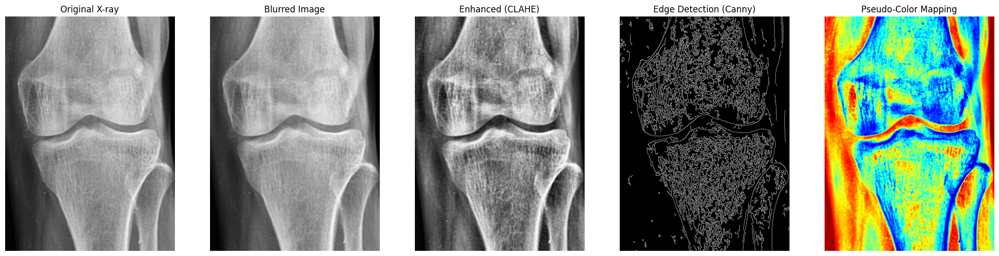

In [20]:
# import os
import random

# Define the folder path
base_path = "/Users/gideonbonwitt/Documents/Msc/Final Project/datasets/cropped_data"

# Categories to process
categories = ["Normal", "Osteopenia", "Osteoporosis"]

# Function to process multiple images
def process_multiple_images(base_path, categories, num_images=3):
    for category in categories:
        category_path = os.path.join(base_path, category)

        # Ensure the folder exists and contains images
        if not os.path.exists(category_path) or not os.listdir(category_path):
            print(f"No images found in {category_path}. Skipping...")
            continue

        # Get all image files in the category
        image_files = [
            os.path.join(category_path, f)
            for f in os.listdir(category_path)
            if f.lower().endswith((".png", ".jpg", ".jpeg"))
        ]

        # Randomly select images to process
        selected_images = random.sample(image_files, min(num_images, len(image_files)))

        print(f"\nProcessing {len(selected_images)} images from category: {category}")

        # Process each selected image
        for image_path in selected_images:
            print(f"Processing image: {image_path}")
            process_xray_adaptive(image_path)

# Call the function
process_multiple_images(base_path, categories, num_images=10)